In [1]:
import numpy as np
from sklearn.ensemble import GradientBoostingClassifier
from utilities import *
from sklearn.manifold import TSNE

In [ ]:
X_train, X_test, y_train, y_test = prepare_data(get_pT=False)

Loading prepared data from ..\data\prepared_data.npz


In [3]:
gbdt_classifier = GradientBoostingClassifier(random_state=42)
gbdt_classifier.fit(X_train, y_train)

GradientBoostingClassifier(random_state=42)

In [4]:
y_pred = gbdt_classifier.predict(X_test)

In [5]:
evaluate_sklearn_model(y_test, y_pred)

Accuracy: 0.9432
Classification Report:
               precision    recall  f1-score   support

         0.0       0.96      0.95      0.95     28279
         1.0       0.92      0.94      0.93     17903

    accuracy                           0.94     46182
   macro avg       0.94      0.94      0.94     46182
weighted avg       0.94      0.94      0.94     46182

Confusion Matrix:
 [[26816  1463]
 [ 1159 16744]]
Mean Squared Error:
 0.05677536702611407


In [6]:
X_test_embedded = TSNE(n_components=2, random_state=42).fit_transform(X_test) 

In [7]:
X_test_embedded_3D = TSNE(n_components=3, random_state=42).fit_transform(X_test)

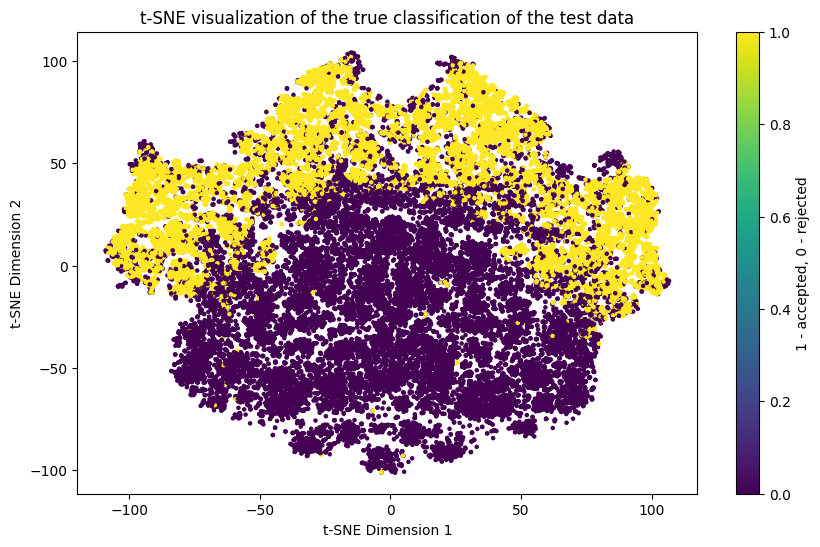

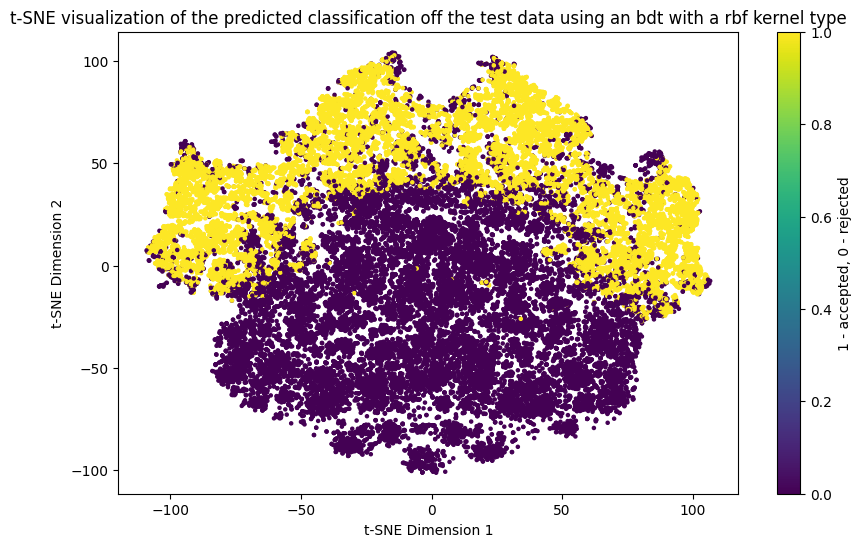

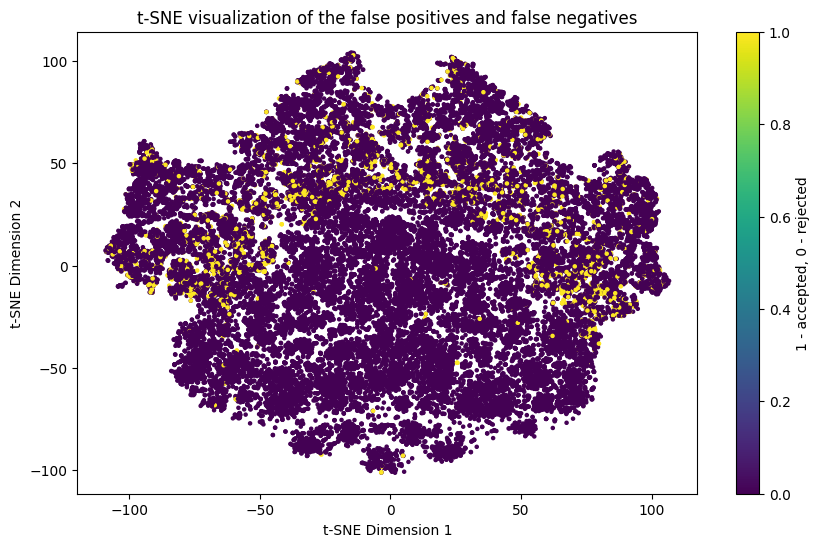

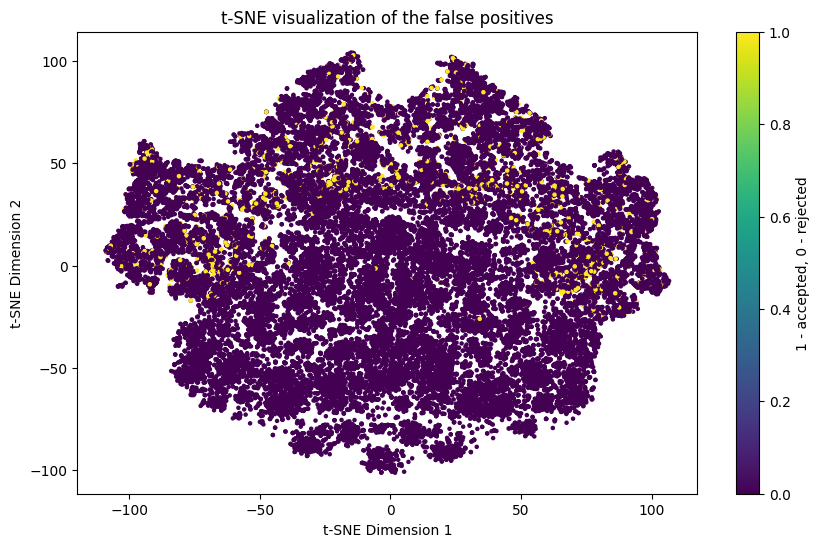

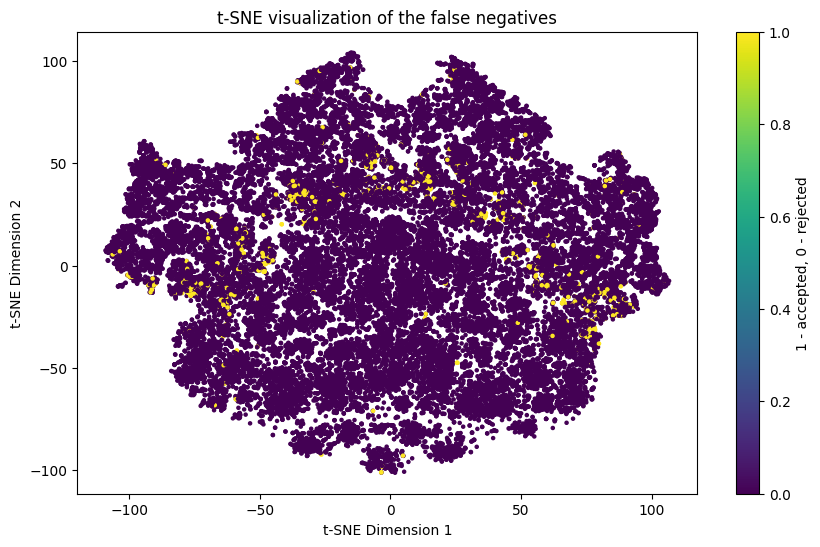

In [9]:
y_fpfn = np.logical_xor(y_test, y_pred)
y_fn = np.logical_and(y_test,np.logical_not(y_pred))
y_fp = np.logical_and(np.logical_not(y_test), y_pred)

plot_2D_TSNE(X_test_embedded,y_test,"t-SNE visualization of the true classification of the test data")
plot_2D_TSNE(X_test_embedded,y_pred,"t-SNE visualization of the predicted classification off the test data using an bdt with a rbf kernel type")
plot_2D_TSNE(X_test_embedded,y_fpfn,"t-SNE visualization of the false positives and false negatives")
plot_2D_TSNE(X_test_embedded,y_fp,"t-SNE visualization of the false positives")
plot_2D_TSNE(X_test_embedded,y_fn,"t-SNE visualization of the false negatives")

plot_3D_TSNE(X_test_embedded_3D, y_test)
plot_3D_TSNE(X_test_embedded_3D, y_pred)
plot_3D_TSNE(X_test_embedded_3D, y_fpfn)
plot_3D_TSNE(X_test_embedded_3D, y_fp)
plot_3D_TSNE(X_test_embedded_3D, y_fn)